Import libs

In [1]:
import xarray
import matplotlib.pyplot as plt
import numpy as np
import datetime
import cv2
from tqdm import tqdm
from scipy.interpolate import NearestNDInterpolator
%matplotlib inline

Read data

In [24]:
input_path = (
    r"/home/fberanek/Desktop/projects/hackathons/cassini/CassiniHackathon.Data/input_data/sar/mariupol_2021-2023.nc"
)
ds = xarray.load_dataset(input_path)

# Convert xarray DataSet to a (bands, t, x, y) DataArray
data = ds[["VV", "VH"]].to_array(dim="bands")

In [ ]:
data[{"t":0, "bands":0}].shape

Vizulize one sample from each band

In [ ]:
fig, ax = plt.subplots(figsize=(22, 18))
ax.set_axis_off()
# plot the data - single image
data[{"t":18,"bands": 0}].plot.imshow(ax=ax, add_labels=False)

plt.show()

In [ ]:
fig, ax = plt.subplots(figsize=(22, 18))
ax.set_axis_off()
# plot the data - single image
data[{"t": 18, "bands": 1}].plot.imshow(ax=ax, add_labels=False)

plt.show()

Get all frames into lists

In [3]:
threshold = 0.05

In [ ]:
# Get all VVs
list_of_images = []
list_of_dates = []
list_of_used_indexes = []
for i in tqdm(range(data.shape[1])):  # data.shape[1]
    img = np.array(data[{"t": i, "bands": 0}])
    date = datetime.datetime.fromtimestamp(data["t"][i].item() / 10**9).strftime("%Y/%m/%d")
    if np.sum(np.isnan(img)) / (np.size(img))<threshold:
        # TODO What to do with Nans?
        # img = np.nan_to_num(img)
        mask = np.where(~np.isnan(img))
        interp = NearestNDInterpolator(np.transpose(mask), img[mask])
        filled_data = interp(*np.indices(img.shape))
        # Clip min max
        # img_clipped = np.clip(img, a_min=-125, a_max=125)
        # Convert to RGB int
        # img_clipped += 125
        # Crop to int
        # img_clipped = img_clipped.astype(np.uint8)
        list_of_images.append(filled_data)
        list_of_dates.append(date)
        list_of_used_indexes.append(i)
    else:
        print(f"Skipping frame {i} - {date}")

In [ ]:
np.savez(
    "mid_results.npz",
    list_of_images=list_of_images,
    list_of_dates=list_of_dates,
    list_of_used_indexes=list_of_used_indexes,
)

In [11]:
npz = np.load("mid_results.npz", allow_pickle=True)
list_of_images = npz["list_of_images"]
list_of_dates = npz["list_of_dates"]
list_of_used_indexes = npz["list_of_used_indexes"]
list_of_dates

array(['2021/01/02', '2021/01/04', '2021/01/08', '2021/01/10',
       '2021/01/14', '2021/01/16', '2021/01/22', '2021/01/26',
       '2021/01/28', '2021/02/01', '2021/02/03', '2021/02/07',
       '2021/02/09', '2021/02/13', '2021/02/15', '2021/02/19',
       '2021/02/21', '2021/02/25', '2021/02/27', '2021/03/03',
       '2021/03/05', '2021/03/09', '2021/03/11', '2021/03/15',
       '2021/03/17', '2021/03/21', '2021/03/23', '2021/03/27',
       '2021/03/29', '2021/04/02', '2021/04/04', '2021/04/08',
       '2021/04/10', '2021/04/14', '2021/04/16', '2021/04/20',
       '2021/04/22', '2021/04/26', '2021/04/28', '2021/05/02',
       '2021/05/04', '2021/05/08', '2021/05/10', '2021/05/14',
       '2021/05/16', '2021/05/20', '2021/05/22', '2021/05/26',
       '2021/05/28', '2021/06/01', '2021/06/03', '2021/06/07',
       '2021/06/09', '2021/06/13', '2021/06/15', '2021/06/19',
       '2021/06/21', '2021/06/25', '2021/06/27', '2021/07/01',
       '2021/07/03', '2021/07/07', '2021/07/09', '2021/

Convert all frames into video

In [ ]:
images_arr = np.array(list_of_images)
img_max = np.max(np.array(images_arr))
img_min = np.min(np.array(images_arr))
cumulations_array = (images_arr + np.abs(img_min)) / (img_max - img_min)
cumulations_array = (cumulations_array * 255).astype(np.uint8)

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.backends.backend_agg import FigureCanvasAgg as FigureCanvas

image_list = []

for image, image_date, image_index in tqdm(zip(list_of_images, list_of_dates, list_of_used_indexes)):
    # Step 1: Create a figure with matplotlib
    fig, ax = plt.subplots(figsize=(20, 20))
    ax.imshow(image, cmap="Spectral")
    ax.axis("off")
    ax.set_title(f"Image id {list_of_used_indexes}-{image_date}")

    # Step 2: Render the figure to a canvas
    canvas = FigureCanvas(fig)
    canvas.draw()

    # Step 3: Convert the canvas to a NumPy array
    img_array = np.frombuffer(canvas.tostring_rgb(), dtype=np.uint8)
    img_array = img_array.reshape(canvas.get_width_height()[::-1] + (3,))  # Reshape to (height, width, 3)

    # Close the figure to free memory
    plt.close(fig)

    # Step 4: Store the array in a list
    image_list.append(img_array)

In [ ]:
# Output video
output_file = "frame_depth.mp4"
height, width, layers = image_list[0].shape
fps = 2

video = cv2.VideoWriter(output_file, cv2.VideoWriter_fourcc(*"mp4v"), fps, (width, height))

for image in image_list:
    video.write(image)

video.release()
print(f"Video saved as {output_file}")

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.backends.backend_agg import FigureCanvasAgg as FigureCanvas

image_list = []

for image_index, image_date in zip(list_of_used_indexes, list_of_dates):
    # Step 1: Create a figure with matplotlib
    fig, ax = plt.subplots(figsize=(20, 20))
    data[{"t": image_index, "bands": 0}].plot.imshow(ax=ax, add_labels=False)
    ax.axis("off")
    ax.set_title(f"Image id {image_index}-{image_date}")

    # Step 2: Render the figure to a canvas
    canvas = FigureCanvas(fig)
    canvas.draw()

    # Step 3: Convert the canvas to a NumPy array
    img_array = np.frombuffer(canvas.tostring_rgb(), dtype=np.uint8)
    img_array = img_array.reshape(canvas.get_width_height()[::-1] + (3,))  # Reshape to (height, width, 3)

    # Close the figure to free memory
    plt.close(fig)

    # Step 4: Store the array in a list
    image_list.append(img_array)

In [ ]:
# Output video
output_file = "frame_depth_with_bar.mp4"
height, width, layers = image_list[0].shape
fps = 2

video = cv2.VideoWriter(output_file, cv2.VideoWriter_fourcc(*"mp4v"), fps, (width, height))

for image in image_list:
    video.write(image)

video.release()
print(f"Video saved as {output_file}")

Calculate cumulative develpment

In [5]:
list_of_cumulations = []
previous_image = list_of_images[0]
change_array = np.zeros_like(previous_image)


for date, img in tqdm(zip(list_of_dates[1:], list_of_images[1:])):
    change_array += (img - previous_image)
    list_of_cumulations.append(change_array.copy())

237it [00:00, 241.23it/s]


Visualize cumulative changes

In [6]:
cumulations_array = np.array(list_of_cumulations)
cum_max = np.max(np.array(list_of_cumulations))
cum_min = np.min(np.array(list_of_cumulations))
cumulations_array = (cumulations_array + np.abs(cum_min)) / (cum_max - cum_min)
cumulations_array = (cumulations_array * 255).astype(np.uint8)

In [7]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.backends.backend_agg import FigureCanvasAgg as FigureCanvas

image_list = []

for image_id, image in enumerate(cumulations_array):
    # Step 1: Create a figure with matplotlib
    fig, ax = plt.subplots(figsize=(20, 20))
    ax.imshow(image, cmap="Spectral")
    ax.axis("off")
    ax.set_title(f"Image id {list_of_dates[image_id]}")

    # Step 2: Render the figure to a canvas
    canvas = FigureCanvas(fig)
    canvas.draw()

    # Step 3: Convert the canvas to a NumPy array
    img_array = np.frombuffer(canvas.tostring_rgb(), dtype=np.uint8)
    img_array = img_array.reshape(canvas.get_width_height()[::-1] + (3,))  # Reshape to (height, width, 3)

    # Close the figure to free memory
    plt.close(fig)

    # Step 4: Store the array in a list
    image_list.append(img_array)

/tmp/ipykernel_6507/916704588.py:19: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed in 3.10. Use buffer_rgba instead.
  img_array = np.frombuffer(canvas.tostring_rgb(), dtype=np.uint8)


In [8]:
# Output video
output_file = "cumulative_changes.mp4"
height, width, layers = image_list[0].shape
fps = 2

video = cv2.VideoWriter(output_file, cv2.VideoWriter_fourcc(*"mp4v"), fps, (width, height))

for image in image_list:
    video.write(image)

video.release()
print(f"Video saved as {output_file}")

Video saved as cumulative_changes.mp4


Visualize for selected dates

list_of_images = npz["list_of_images"]
list_of_dates = npz["list_of_dates"]
list_of_used_indexes = npz["list_of_used_indexes"]

In [33]:
selected_dates = [
    "2021/12/12",
    "2022/01/23",
    "2022/02/28",
    "2022/04/05",
    "2022/05/11",
]

In [34]:
dates_mask = np.isin(list_of_dates, selected_dates)

selected_images = list_of_images[dates_mask]
selected_indexes = list_of_used_indexes[dates_mask]

Selected depths

/tmp/ipykernel_6507/4243450354.py:19: MatplotlibDeprecationWarning: The tostring_rgb function was deprecated in Matplotlib 3.8 and will be removed in 3.10. Use buffer_rgba instead.
  img_array = np.frombuffer(canvas.tostring_rgb(), dtype=np.uint8)


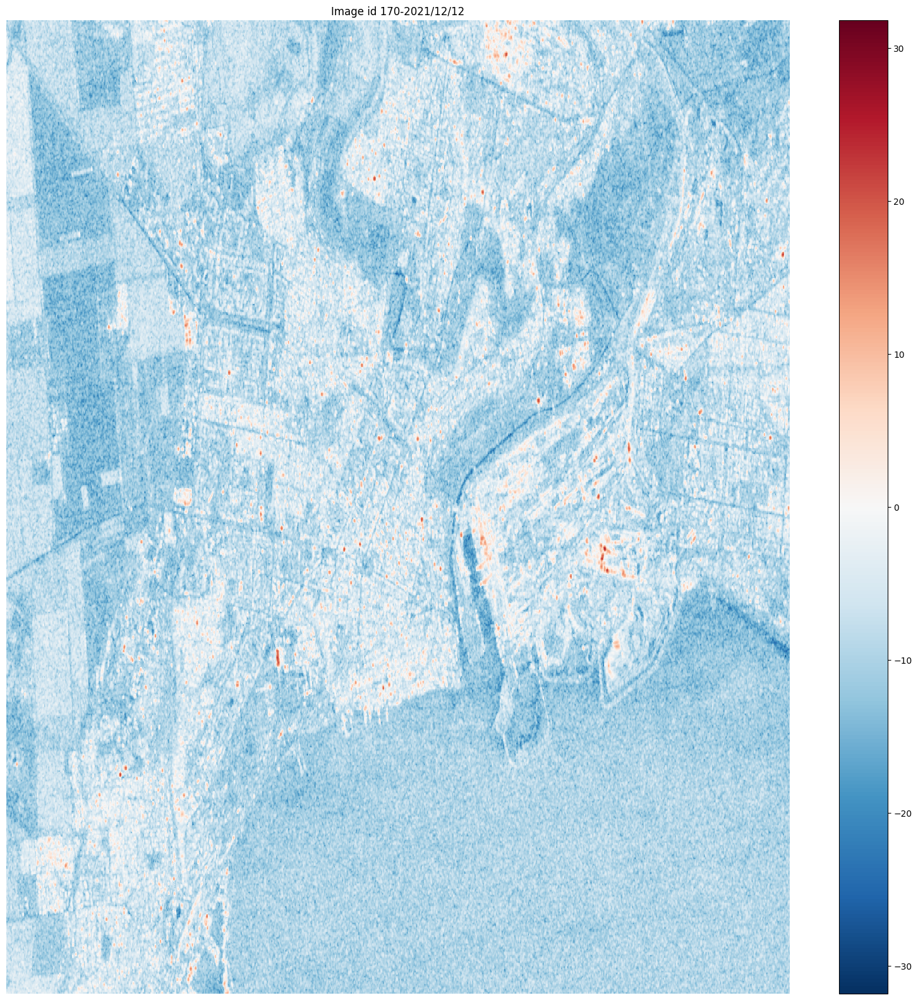

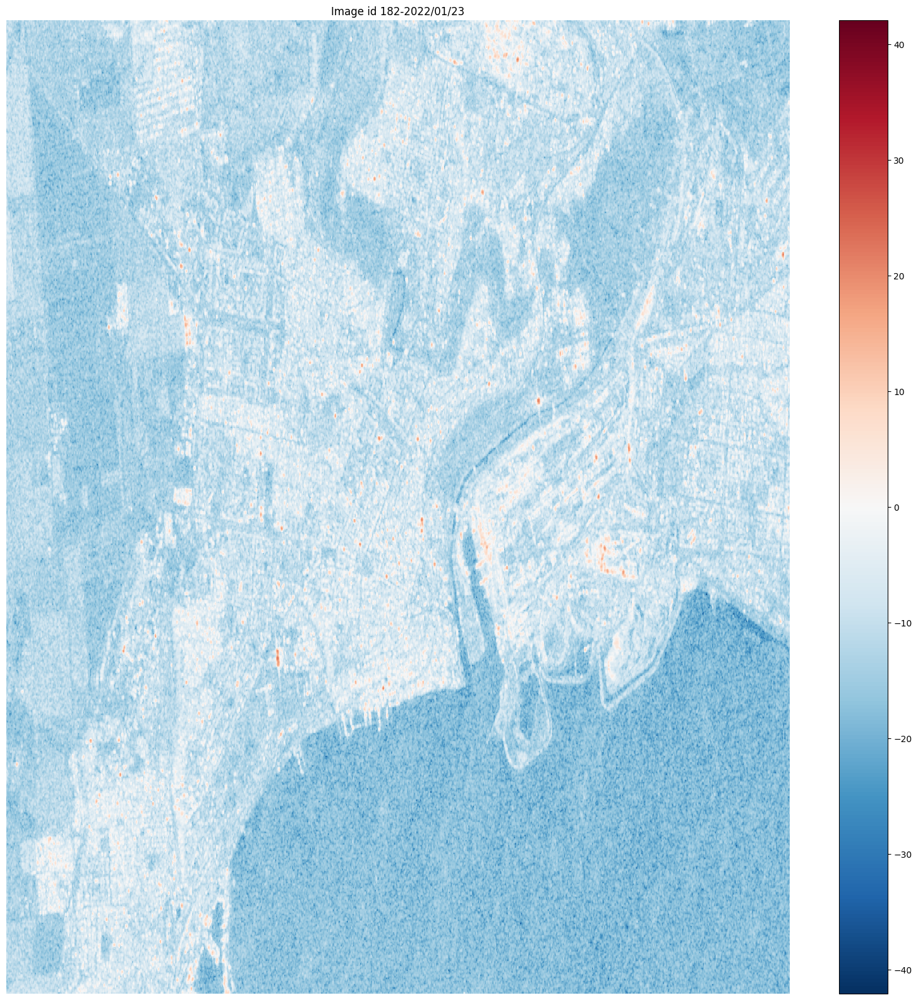

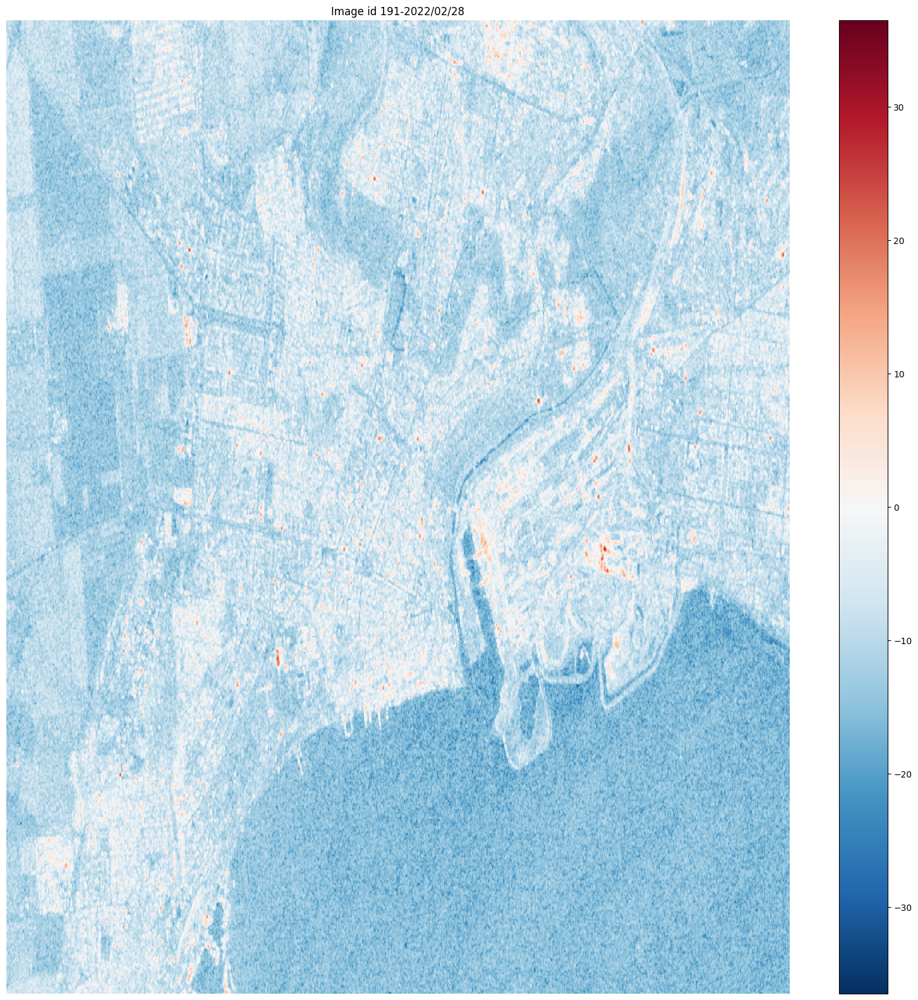

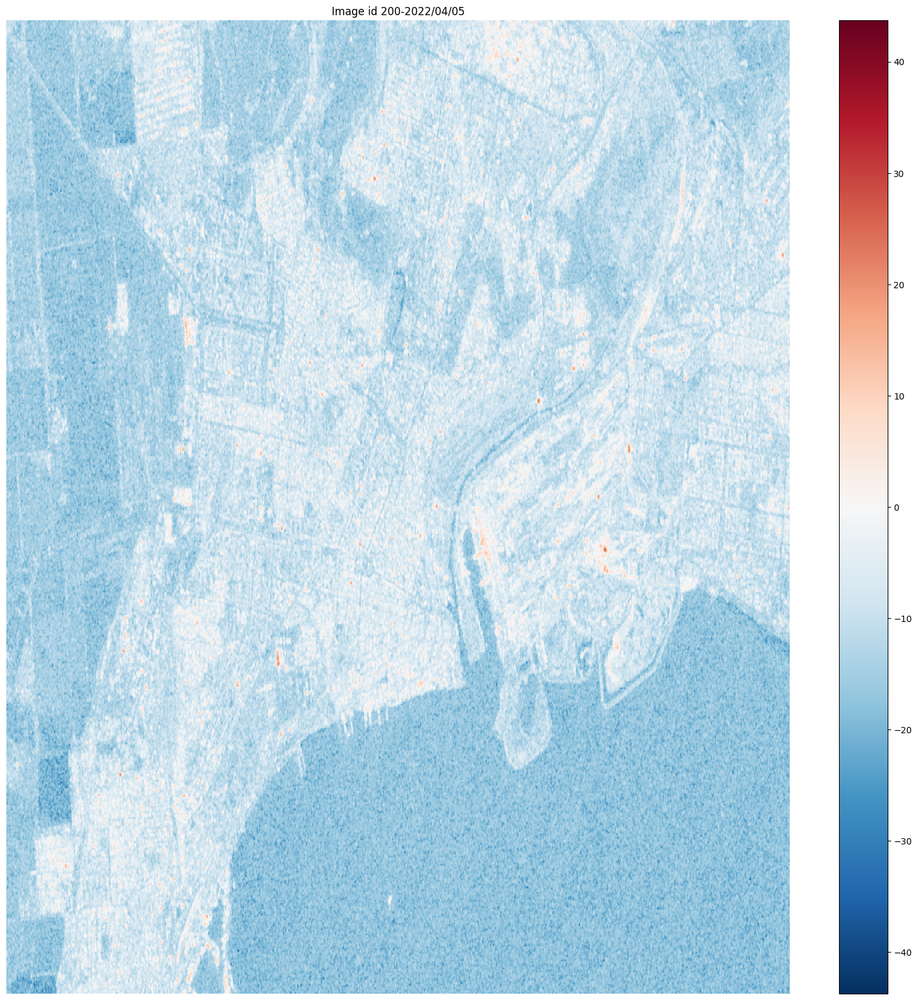

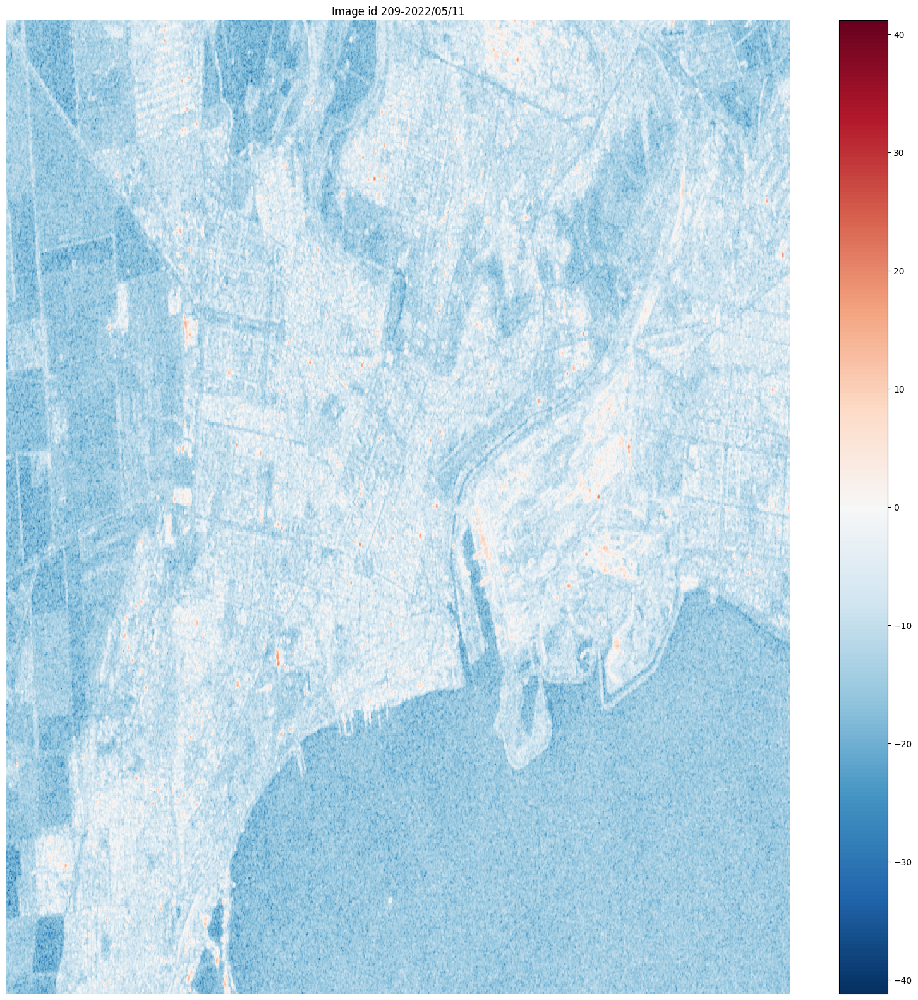

In [35]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.backends.backend_agg import FigureCanvasAgg as FigureCanvas

image_list = []

for image_index, image_date in zip(selected_indexes, selected_dates):
    # Step 1: Create a figure with matplotlib
    fig, ax = plt.subplots(figsize=(20, 20))
    data[{"t": image_index, "bands": 0}].plot.imshow(ax=ax, add_labels=False)
    ax.axis("off")
    ax.set_title(f"Image id {image_index}-{image_date}")

    # Step 2: Render the figure to a canvas
    canvas = FigureCanvas(fig)
    canvas.draw()

    # Step 3: Convert the canvas to a NumPy array
    img_array = np.frombuffer(canvas.tostring_rgb(), dtype=np.uint8)
    img_array = img_array.reshape(canvas.get_width_height()[::-1] + (3,))  # Reshape to (height, width, 3)

    # Close the figure to free memory
    plt.show()
    #plt.close(fig)

    # Step 4: Store the array in a list
    image_list.append(img_array)

Selected deltas

In [36]:
previsous_frame = selected_images[0]
change_arr = np.zeros_like(previsous_frame)
list_of_changes = []

for image in selected_images[1:]:
    change_arr += image - previsous_frame
    list_of_changes.append(change_arr.copy())

In [51]:
changes_arr = np.array(list_of_changes)
change_max = np.max(changes_arr)
change_min = np.min(changes_arr)
changes_arr = (((changes_arr + np.abs(change_min))/(change_max-change_min))*255).astype(np.uint8)

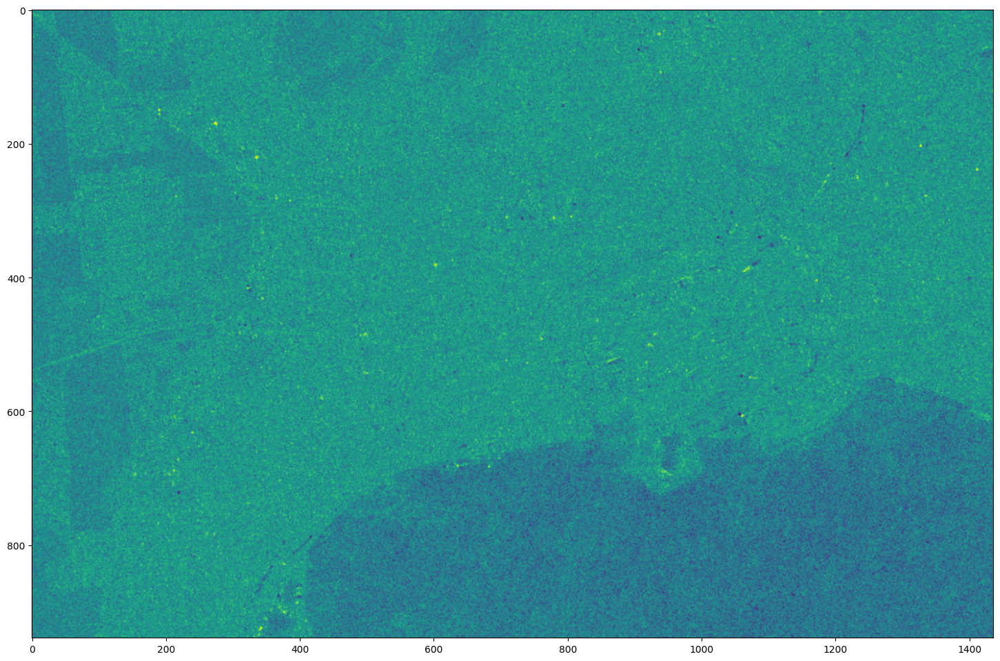

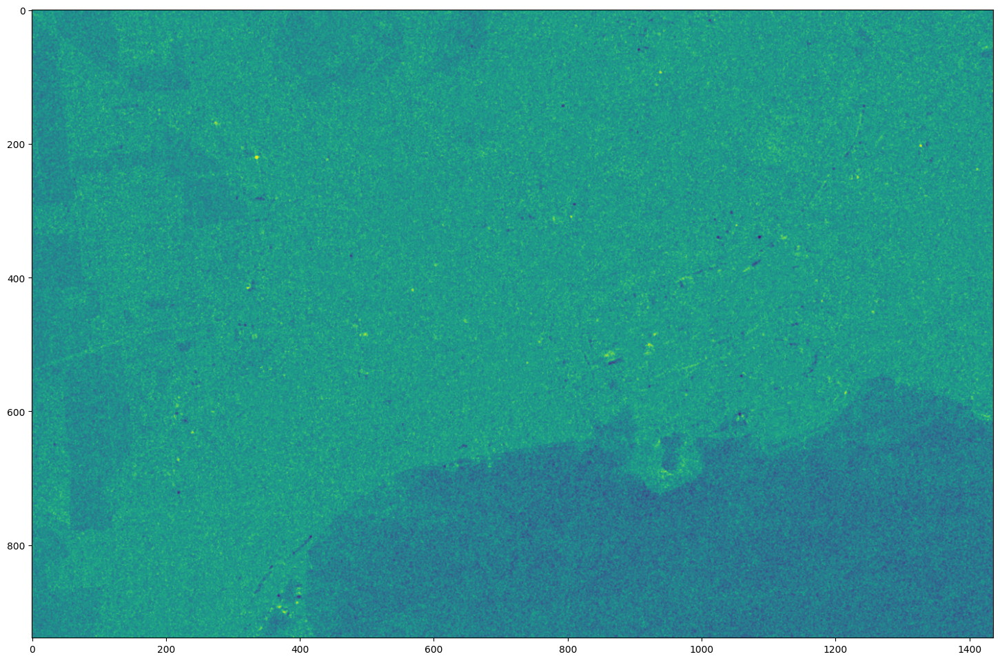

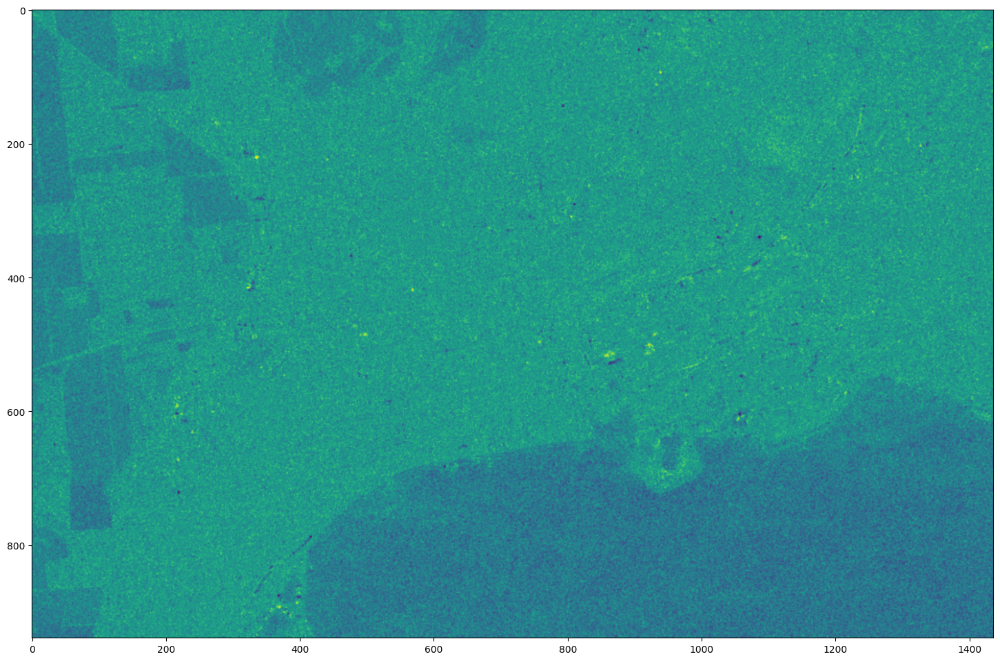

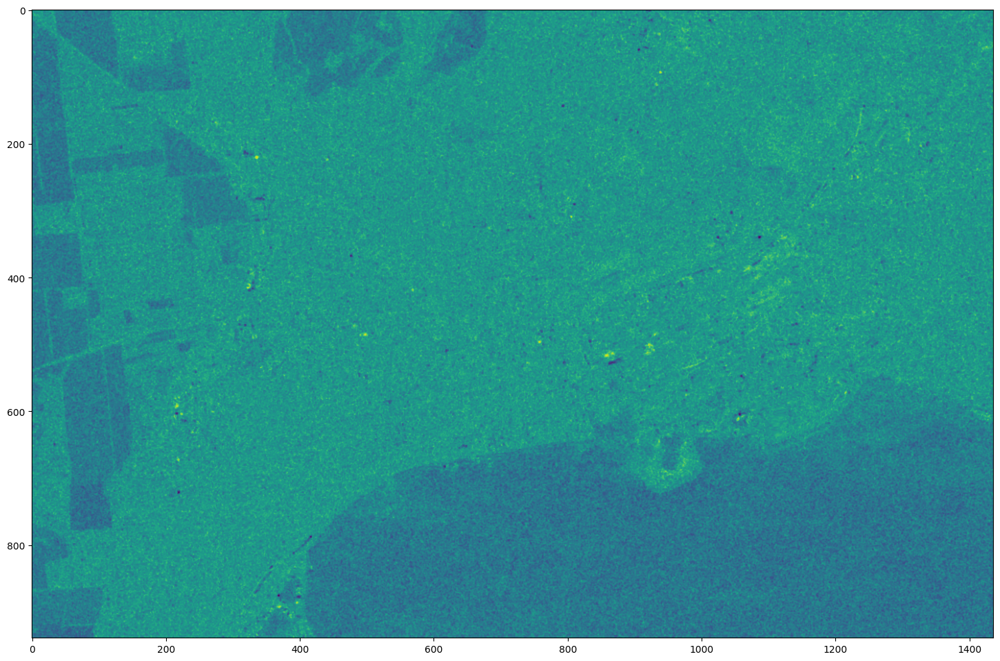

In [54]:
for change in changes_arr:
    plt.figure(figsize=(18,18))
    plt.imshow(change)
    plt.show()

In [56]:
change_arr += image - selected_images[0]

In [57]:
changes_arr = np.array(list_of_changes)
change_max = np.max(changes_arr)
change_min = np.min(changes_arr)
changes_arr = (((changes_arr + np.abs(change_min)) / (change_max - change_min)) * 255).astype(np.uint8)

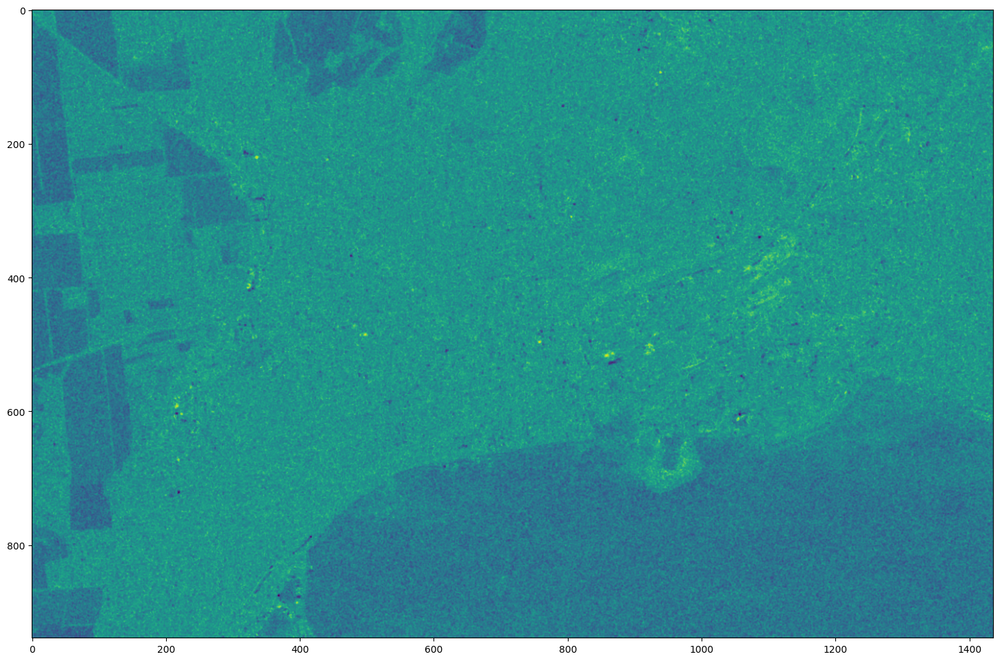

In [58]:
plt.figure(figsize=(18,18))
plt.imshow(change_arr)
plt.show()